In [2]:
# SIMULACIÓN DE ROBOT MANIPULADOR PLANAR DE 2 GDL

import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D

# Configuración para mejores gráficos
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['font.size'] = 12
%matplotlib inline

print(" Librerías importadas correctamente")

 Librerías importadas correctamente


In [4]:
# PARÁMETROS

# Parámetros del eslabón 1 Hombro
m1 = 5.0       # Masa del eslabón 1 (kg)
l1 = 0.5       # Longitud del eslabón 1 (m)
lc1 = 0.25     # Centro de masa del eslabón 1 (m)
I1 = 0.16      # Inercia del eslabón 1 (kg·m²)

# Parámetros del eslabón 2 Codo
m2 = 3.0       # Masa del eslabón 2 (kg)
l2 = 0.3       # Longitud del eslabón 2 (m)
lc2 = 0.15     # Centro de masa del eslabón 2 (m)
I2 = 0.08      # Inercia del eslabón 2 (kg·m²)

# Parámetros generales
g = 9.81       # Gravedad (m/s²)

# Coeficientes de fricción
b1 = 1.86      # Fricción viscosa articulación 1
b2 = 0.16      # Fricción viscosa articulación 2
fc1 = 1.93     # Fricción Coulomb articulación 1
fc2 = 0.3      # Fricción Coulomb articulación 2

print(" Parámetros del robot configurados")

 Parámetros del robot configurados


In [6]:
# Ecuaciones de Euler-Lagrange

def robot_2gdl(t, x):
    """
    x = [q1, q2, dq1, dq2] - vector de estados
    q1, q2: posiciones articulares (rad)
    dq1, dq2: velocidades articulares (rad/s)
    """
    
    # Extraer estados
    q1, q2, dq1, dq2 = x
    
    # MATRIZ DE INERCIA M(q) 
    m11 = m1*lc1**2 + m2*(l1**2 + lc2**2 + 2*l1*lc2*np.cos(q2)) + I1 + I2
    m12 = m2*(lc2**2 + l1*lc2*np.cos(q2)) + I2
    m21 = m2*(lc2**2 + l1*lc2*np.cos(q2)) + I2
    m22 = m2*lc2**2 + I2
    
    M = np.array([[m11, m12],
                  [m21, m22]])
    
    # MATRIZ DE CORIOLIS Y CENTRÍFUGAS C(q,dq) 
    c11 = -2*m2*l1*lc2*np.sin(q2)*dq2
    c12 = -m2*l1*lc2*np.sin(q2)*dq2
    c21 = m2*l1*lc2*np.sin(q2)*dq1
    c22 = 0
    
    C = np.array([[c11, c12],
                  [c21, c22]])
    
    # VECTOR GRAVITACIONAL g(q) 
    g1 = g*(lc1*m1*np.sin(q1) + m2*l1*np.sin(q1) + m2*lc2*np.sin(q1 + q2))
    g2 = g*(lc2*m2*np.sin(q1 + q2))
    
    G = np.array([g1, g2])
    
    # VECTOR DE FRICCIÓN 
    # Aproximación de la función signo usando tanh
    friccion1 = b1*dq1 + fc1*np.tanh(100000*dq1)
    friccion2 = b2*dq2 + fc2*np.tanh(100000*dq2)
    
    F = np.array([friccion1, friccion2])
    
    # TORQUES DE ENTRADA 
    tau1 = (1 - np.exp(-0.8*t))*32 + 56*np.sin(16*t + 0.1) + 12*np.sin(20*t + 0.15)
    tau2 = (1 - np.exp(-1.8*t))*1.2 + 8*np.sin(26*t + 0.08) + 2*np.sin(12*t + 0.34)
    
    tau = np.array([tau1, tau2])
    
    # ECUACIÓN DINÁMICA: M(q)·ddq + C(q,dq)·dq + G(q) + F(dq) = tau
    # Despejar ddq: ddq = M(q)^{-1} · [tau - C(q,dq)·dq - G(q) - F(dq)]
    
    # Términos del lado derecho
    right_side = tau - C @ np.array([dq1, dq2]) - G - F
    
    # Aceleraciones articulares
    try:
        ddq = np.linalg.solve(M, right_side)
    except np.linalg.LinAlgError:
        # En caso de matriz singular, usar pseudoinversa
        ddq = np.linalg.pinv(M) @ right_side
    
    ddq1, ddq2 = ddq
    
    # DERIVADAS DEL VECTOR DE ESTADO
    # dx/dt = [dq1, dq2, ddq1, ddq2]
    return [dq1, dq2, ddq1, ddq2]

print(" Función de dinámica del robot de 2 GDL definida")

 Función de dinámica del robot de 2 GDL definida


In [8]:
# SIMULACIÓN

# Parámetros de simulación
ti = 0.0         # Tiempo inicial (s)
tf = 10.0        # Tiempo final (s)
h = 0.0025       # Paso de tiempo (s)
ts = np.arange(ti, tf, h)

# Condiciones iniciales [q1, q2, dq1, dq2]
x0 = [0.0, 0.0, 0.0, 0.0]  # Reposo completo

print(" Ejecutando simulación del robot de 2 GDL...")

# Resolver ecuaciones diferenciales
sol = solve_ivp(robot_2gdl, [ti, tf], x0, t_eval=ts, method='RK45', rtol=1e-3)

# Extraer resultados
t = sol.t
q1 = sol.y[0]    # Posición articular 1
q2 = sol.y[1]    # Posición articular 2
dq1 = sol.y[2]   # Velocidad articular 1
dq2 = sol.y[3]   # Velocidad articular 2

print(f" Simulación completada - {len(t)} puntos calculados")

 Ejecutando simulación del robot de 2 GDL...
 Simulación completada - 4000 puntos calculados


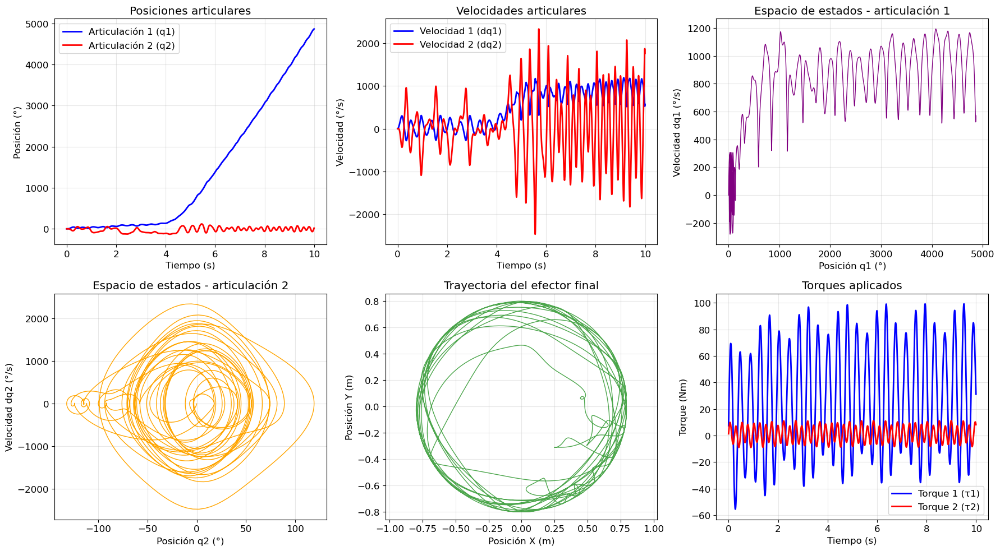

In [10]:
# RESULTADOS

# Convertir a grados
q1_grados = np.rad2deg(q1)
q2_grados = np.rad2deg(q2)
dq1_grados = np.rad2deg(dq1)
dq2_grados = np.rad2deg(dq2)

fig, axes = plt.subplots(2, 3, figsize=(18, 10))


# Posiciones articulares
axes[0,0].plot(t, q1_grados, 'b-', linewidth=2, label='Articulación 1 (q1)')
axes[0,0].plot(t, q2_grados, 'r-', linewidth=2, label='Articulación 2 (q2)')
axes[0,0].set_xlabel('Tiempo (s)')
axes[0,0].set_ylabel('Posición (°)')
axes[0,0].set_title('Posiciones articulares')
axes[0,0].legend()
axes[0,0].grid(True, alpha=0.3)

# Velocidades articulares
axes[0,1].plot(t, dq1_grados, 'b-', linewidth=2, label='Velocidad 1 (dq1)')
axes[0,1].plot(t, dq2_grados, 'r-', linewidth=2, label='Velocidad 2 (dq2)')
axes[0,1].set_xlabel('Tiempo (s)')
axes[0,1].set_ylabel('Velocidad (°/s)')
axes[0,1].set_title('Velocidades articulares')
axes[0,1].legend()
axes[0,1].grid(True, alpha=0.3)

# Espacio de estados - articulación 1
axes[0,2].plot(q1_grados, dq1_grados, 'purple', linewidth=1)
axes[0,2].set_xlabel('Posición q1 (°)')
axes[0,2].set_ylabel('Velocidad dq1 (°/s)')
axes[0,2].set_title('Espacio de estados - articulación 1')
axes[0,2].grid(True, alpha=0.3)

# Espacio de estados - articulación 2
axes[1,0].plot(q2_grados, dq2_grados, 'orange', linewidth=1)
axes[1,0].set_xlabel('Posición q2 (°)')
axes[1,0].set_ylabel('Velocidad dq2 (°/s)')
axes[1,0].set_title('Espacio de estados - articulación 2')
axes[1,0].grid(True, alpha=0.3)

# Trayectoria en el espacio cartesiano
# Calcular posiciones cartesianas de los eslabones
x1 = l1 * np.sin(q1)
y1 = -l1 * np.cos(q1)
x2 = x1 + l2 * np.sin(q1 + q2)
y2 = y1 - l2 * np.cos(q1 + q2)

axes[1,1].plot(x2, y2, 'g-', linewidth=1, alpha=0.7)
axes[1,1].set_xlabel('Posición X (m)')
axes[1,1].set_ylabel('Posición Y (m)')
axes[1,1].set_title('Trayectoria del efector final')
axes[1,1].grid(True, alpha=0.3)
axes[1,1].axis('equal')

# Torques aplicados
tau1 = [(1 - np.exp(-0.8*ti))*32 + 56*np.sin(16*ti + 0.1) + 12*np.sin(20*ti + 0.15) for ti in t]
tau2 = [(1 - np.exp(-1.8*ti))*1.2 + 8*np.sin(26*ti + 0.08) + 2*np.sin(12*ti + 0.34) for ti in t]

axes[1,2].plot(t, tau1, 'b-', linewidth=2, label='Torque 1 (τ1)')
axes[1,2].plot(t, tau2, 'r-', linewidth=2, label='Torque 2 (τ2)')
axes[1,2].set_xlabel('Tiempo (s)')
axes[1,2].set_ylabel('Torque (Nm)')
axes[1,2].set_title('Torques aplicados')
axes[1,2].legend()
axes[1,2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [12]:
# ANIMACIÓN DEL ROBOT 

def animar_robot_2gdl(t, q1, q2, num_frames=200):
    """
    Crear animación del robot de 2 GDL
    """
    # frames equiespaciados
    indices = np.linspace(0, len(t)-1, num_frames, dtype=int)
    
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_xlim(-1.0, 1.0)
    ax.set_ylim(-1.0, 1.0)
    ax.set_aspect('equal')
    ax.grid(True, alpha=0.3)
    ax.set_title('Animación del Robot de 2 GDL')
    ax.set_xlabel('X (m)')
    ax.set_ylabel('Y (m)')
    
    # Inicializar líneas
    line, = ax.plot([], [], 'o-', linewidth=4, markersize=8)
    trayectoria, = ax.plot([], [], 'g-', linewidth=1, alpha=0.5)
    
    # Almacenar trayectoria
    x_tray, y_tray = [], []
    
    def animate(i):
        idx = indices[i]
        
        # Calcular posiciones
        x0, y0 = 0, 0
        x1 = l1 * np.sin(q1[idx])
        y1 = -l1 * np.cos(q1[idx])
        x2 = x1 + l2 * np.sin(q1[idx] + q2[idx])
        y2 = y1 - l2 * np.cos(q1[idx] + q2[idx])
        
        # Actualizar línea del robot
        line.set_data([x0, x1, x2], [y0, y1, y2])
        
        # Actualizar trayectoria
        x_tray.append(x2)
        y_tray.append(y2)
        trayectoria.set_data(x_tray, y_tray)
        
        return line, trayectoria
    
    anim = FuncAnimation(fig, animate, frames=num_frames, interval=50, blit=True)
    plt.close()
    
    return anim

print(" Generando animación...")
anim = animar_robot_2gdl(t, q1, q2)

from IPython.display import HTML
HTML(anim.to_jshtml())

 Generando animación...


Animation size has reached 20982821 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
